In [1]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb

In [2]:
# Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7, 0.8, 20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list("my_colormap", colorsComb)

In [3]:
# mpl.use("module://ipykernel.pylab.backend_inline")
sc.logging.print_header()
sc.set_figure_params(facecolor="white", figsize=(4, 4), dpi_save=300, dpi=100)
sc.settings.verbosity = 3

/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.8.1 pandas==1.4.2 scikit-learn==1.1.1 statsmodels==0.13.2 python-igraph==0.9.10 pynndescent==0.5.7


## Saving data

In [4]:
file_path = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Visium/080822/' 
#this is my file path please adapt it to your directory

The data directory contains all processed data and `anndata` files. 

In [5]:
data_dir = file_path + 'data/' 

The tables directory contains all tabular data output, e.g. in `.csv` or `.xls` file format. That applies to differential expression test results or overview tables such as the number of cells per cell type.

In [6]:
table_dir = file_path + 'table/'

The default figure path is a POSIX path calles 'figures'. If you don't change the default figure directory, scanpy creates a subdirectory where this notebook is located.  

In [7]:
sc.settings.figdir = file_path + 'figures/'

**Comment:** When you repeat certain analyses, it might be helpful to set a date variable and add it to every figure and table (see `datetime` Python package).

In [8]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

# Reading data

In [9]:
adata_spatial_3dpi_V = sc.read_visium(
    "/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Visium/data_raw/A_3dpi_V/outs/", count_file="filtered_feature_bc_matrix.h5"
)

adata_spatial_int = sc.read_visium(
    "/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Visium/data_raw/D_Intact/outs/", count_file="filtered_feature_bc_matrix.h5"
)

reading /Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Visium/data_raw/A_3dpi_V/outs/filtered_feature_bc_matrix.h5
 (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


reading /Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Visium/data_raw/D_Intact/outs/filtered_feature_bc_matrix.h5
 (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [10]:
adata_spatial_3dpi_V

AnnData object with n_obs × n_vars = 1740 × 27998
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [11]:
adata_spatial_3dpi_V.var_names_make_unique()
adata_spatial_int.var_names_make_unique()

In [12]:
# merge into one dataset
adata = adata_spatial_int.concatenate(
    adata_spatial_3dpi_V,
    join='outer',
    batch_key="library_id",
    uns_merge="unique",
    batch_categories=['D_Intact','A_3dpi_V']
)

/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [13]:
adata.var_names_make_unique()

In [14]:
adata

AnnData object with n_obs × n_vars = 3731 × 27998
    obs: 'in_tissue', 'array_row', 'array_col', 'library_id'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [15]:
adata.var["mt"] = adata.var_names.str.startswith("mt-")

In [16]:
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 3731 × 27998
    obs: 'in_tissue', 'array_row', 'array_col', 'library_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'

/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='n_genes_by_counts'>

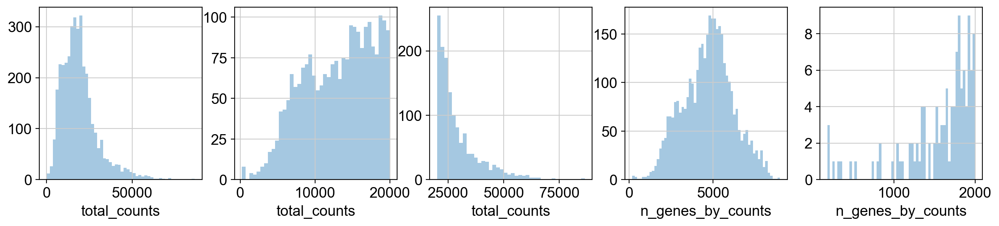

In [18]:
fig, axs = plt.subplots(1, 5, figsize=(16, 3))

sb.distplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sb.distplot(
    adata.obs["total_counts"][adata.obs["total_counts"] < 20000],
    kde=False,
    bins=40,
    ax=axs[1],
)
sb.distplot(
    adata.obs["total_counts"][adata.obs["total_counts"] > 20000],
    kde=False,
    bins=40,
    ax=axs[2],
)
sb.distplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[3])
sb.distplot(
    adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 2000],
    kde=False,
    bins=60,
    ax=axs[4],
)

<AxesSubplot:xlabel='pct_counts_mt'>

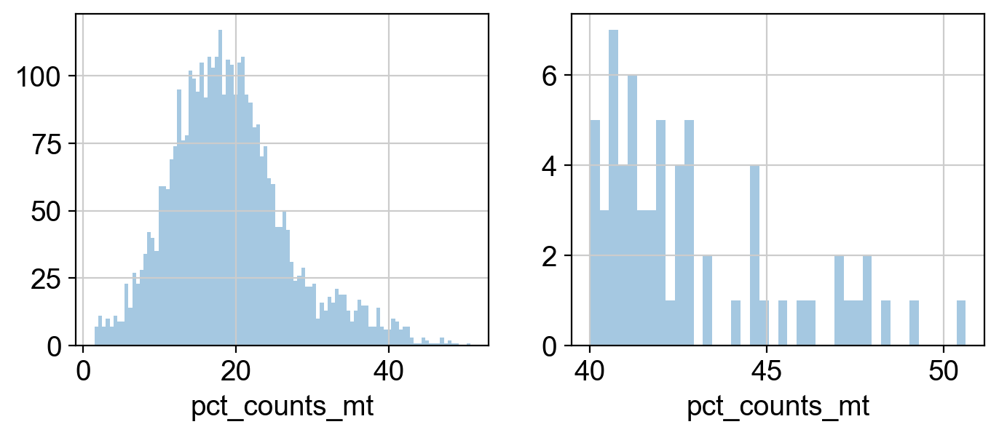

In [19]:
fig, axs = plt.subplots(1, 2, figsize=(8, 3))

sb.distplot(adata.obs["pct_counts_mt"], bins=100, kde=False, ax=axs[0])
sb.distplot(
    adata.obs["pct_counts_mt"][adata.obs["pct_counts_mt"] > 40],
    kde=False,
    bins=40,
    ax=axs[1],
)

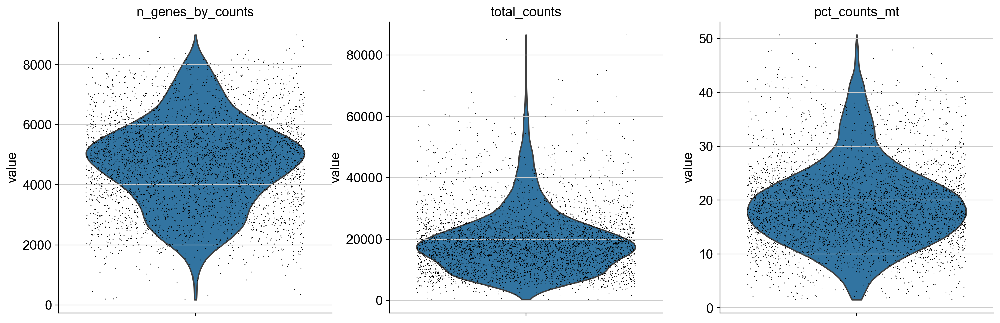

In [20]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

In [21]:
sc.pp.filter_cells(adata, min_counts=1500)
adata = adata[adata.obs["pct_counts_mt"] < 45] 
print(f"#cells after MT filter: {adata.n_obs}")
sc.pp.filter_genes(adata, min_cells=10)

filtered out 9 cells that have less than 1500 counts
#cells after MT filter: 3710
filtered out 11693 genes that are detected in less than 10 cells


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


In [22]:
adata

AnnData object with n_obs × n_vars = 3710 × 16305
    obs: 'in_tissue', 'array_row', 'array_col', 'library_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

In [23]:
#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [24]:
adata

AnnData object with n_obs × n_vars = 3710 × 16305
    obs: 'in_tissue', 'array_row', 'array_col', 'library_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'
    layers: 'counts'

# Manifold embedding and clustering based on transcriptional similarity

In [25]:
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=2000, inplace=True)

normalizing counts per cell
    finished (0:00:00)
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [26]:
adata.raw = adata

In [27]:
adata.write(data_dir+'adata_spatial_3dpi_V_intact_postnorm.h5ad')

In [28]:
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


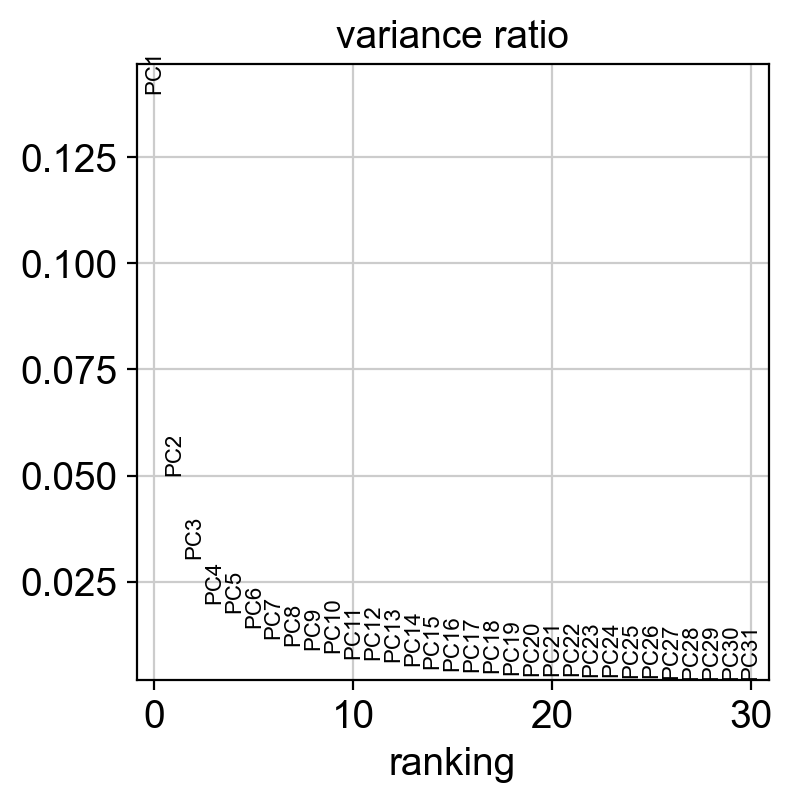

In [29]:
sc.pl.pca_variance_ratio(adata)

In [30]:
sc.pp.pca(adata, n_comps=17, use_highly_variable=True, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=17
    finished (0:00:00)


In [31]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata, key_added="clusters08", resolution=0.8 )
sc.tl.leiden(adata, key_added="clusters1", resolution=1 )

computing neighbors
    using 'X_pca' with n_pcs = 17
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)
running Leiden clustering
    finished: found 16 clusters and added
    'clusters08', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 20 clusters and added
    'clusters1', the cluster labels (adata.obs, categorical) (0:00:00)


In [36]:
sc.tl.leiden(adata, key_added="clusters09", resolution=0.9 )

running Leiden clustering
    finished: found 18 clusters and added
    'clusters09', the cluster labels (adata.obs, categorical) (0:00:00)


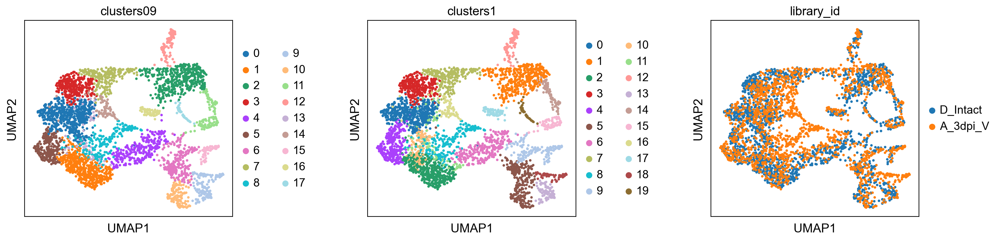

In [38]:
sc.pl.umap(
    adata, color=["clusters09","clusters1", "library_id"], palette=sc.pl.palettes.default_20, wspace=0.5,
)

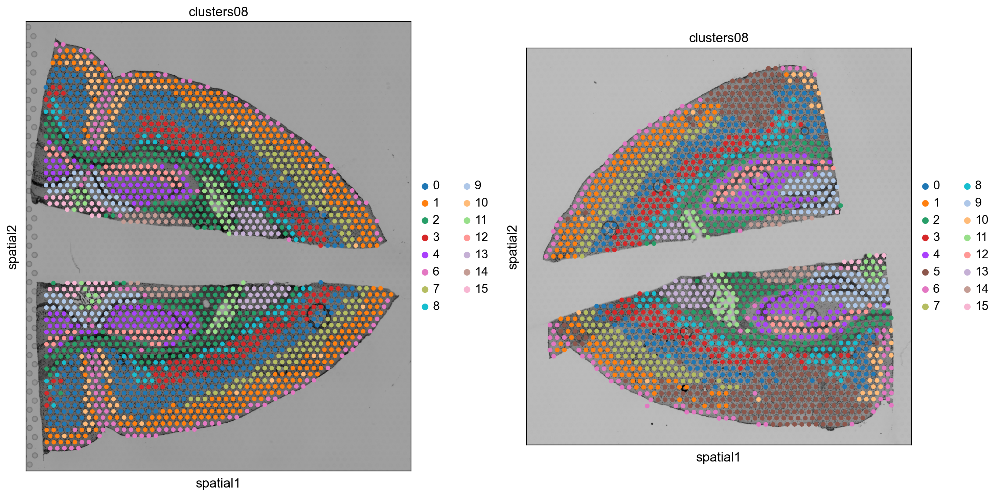

In [33]:
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

for i, library in enumerate(
    ['D_Intact','A_3dpi_V']
):
    ad = adata[adata.obs.library_id == library, :].copy()
    sc.pl.spatial(
        ad,
        img_key="hires",
        library_id=library,
        color=["clusters08"],
        size=1, 
        show=False,
        ax=axs[i],
    )

plt.tight_layout()


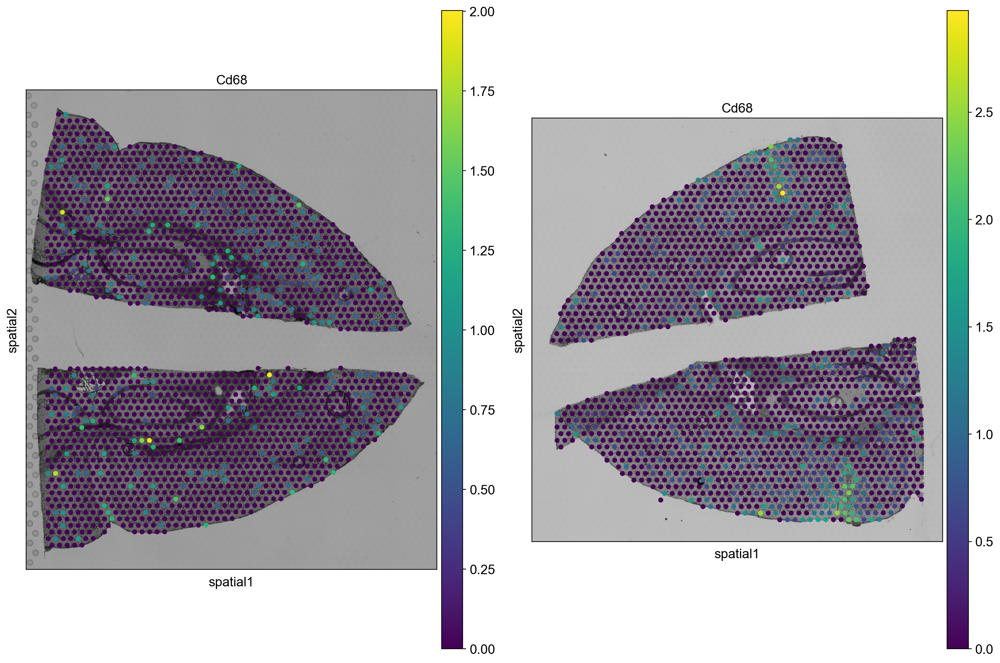

In [48]:
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

for i, library in enumerate(
    ['D_Intact','A_3dpi_V']
):
    ad = adata[adata.obs.library_id == library, :].copy()
    sc.pl.spatial(
        ad,
        img_key="hires",
        library_id=library,
        color=["Cd68"],
        size=1, 
        show=False,
        ax=axs[i],
    )

plt.tight_layout()


In [40]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata, groupby='clusters08', key_added='rank_genes_clusters08', method='t-test_overestim_var')

ranking genes
    finished: added to `.uns['rank_genes_clusters08']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 17
Storing dendrogram info using `.uns['dendrogram_clusters08']`


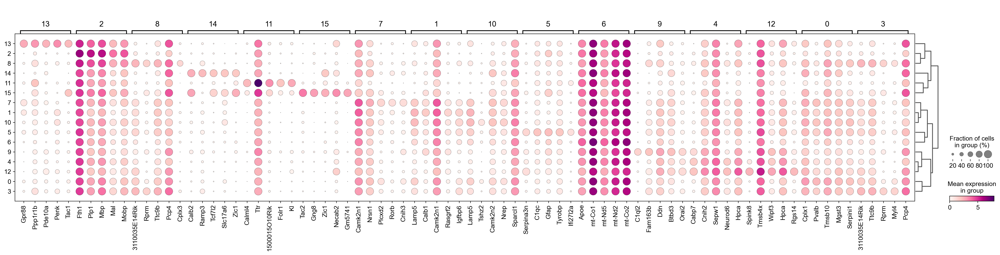

In [41]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, key='rank_genes_clusters08',cmap='RdPu',  )

categories: 0, 1, 2, etc.
var_group_labels: 5


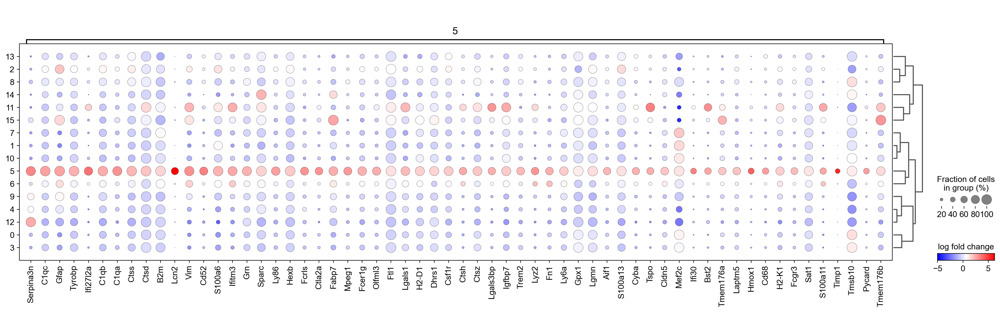

In [47]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata, n_genes=60,groups='5', key='rank_genes_clusters08',values_to_plot='logfoldchanges', 
                                min_logfoldchange=1, vmin=-5, cmap='bwr', save='cl5viviumall.png' )

In [43]:
result = adata.uns['rank_genes_clusters08']
groups = result['names'].dtype.names
adata_micro_proc_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [44]:
adata_micro_proc_genes.to_csv(table_dir + 'adata_vsium_cluster08.csv')

In [50]:
cluster2annotation = {
    '0': 'I',
    '1': 'II',
    '2': 'III',
    '3': 'IV',
    '4': 'V',
    '5': 'VI',
    '6': 'VII',
    '7': 'VIII',
    '8': 'IX',
    '9': 'X',
    '10': 'XI',
    '11': 'XII',
    '12': 'XIII',
    '13': 'XIV',
    '14': 'XV',
    '15': 'XVI',

    
}

In [51]:
adata.obs['clusters_LA'] = adata.obs['clusters08'].map(cluster2annotation).astype('category')

In [52]:
adata.obs['clusters_LA'].value_counts()

I       567
II      442
III     398
IV      347
V       293
VI      259
VII     254
VIII    252
IX      196
X       157
XI      118
XII     117
XIII    113
XIV      92
XV       62
XVI      43
Name: clusters_LA, dtype: int64

In [53]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata, groupby='clusters_LA', key_added='rank_genes_clusters_LA', method='t-test_overestim_var')

ranking genes
    finished: added to `.uns['rank_genes_clusters_LA']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 17
Storing dendrogram info using `.uns['dendrogram_clusters_LA']`


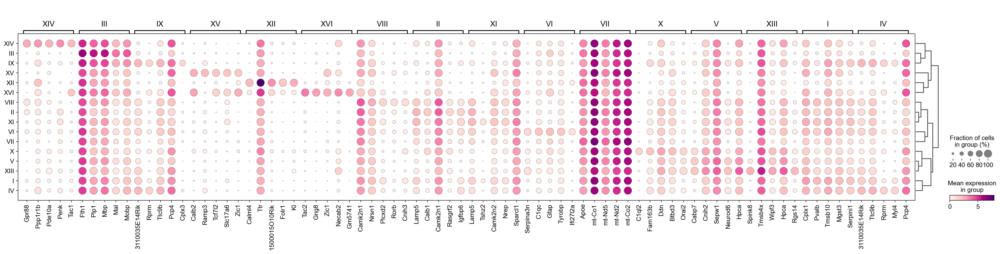

In [54]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, key='rank_genes_clusters_LA', groupby='clusters_LA',cmap='RdPu',  )

categories: I, II, III, etc.
var_group_labels: VI


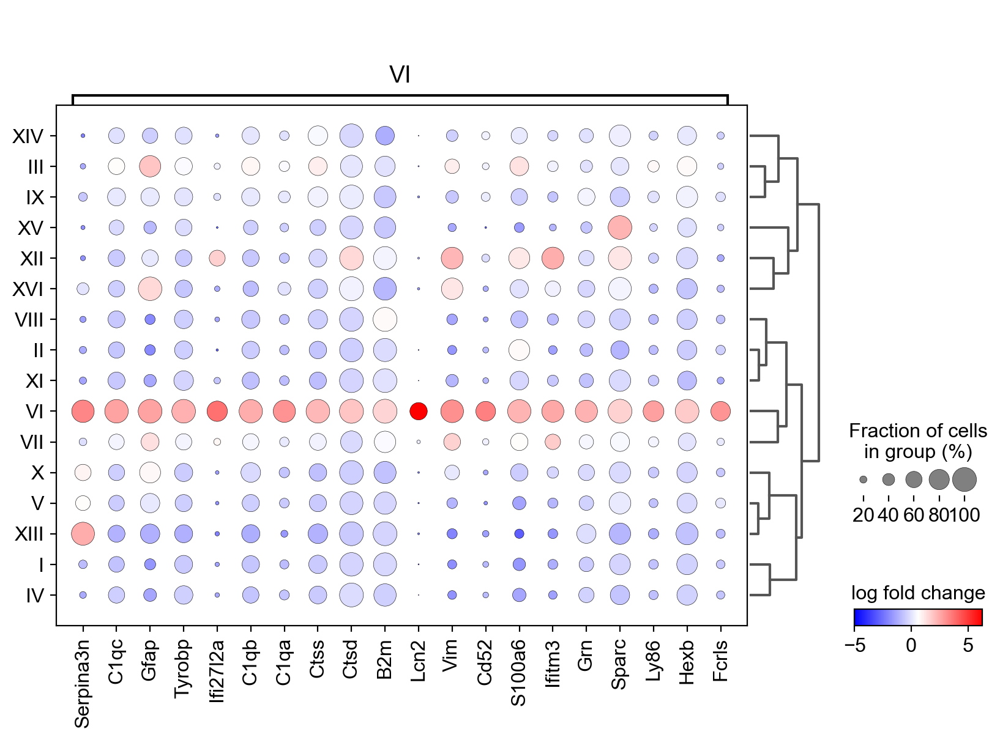

In [59]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata, n_genes=20,groups=['VI'], key='rank_genes_clusters_LA',values_to_plot='logfoldchanges', 
                                min_logfoldchange=1, vmin=-5, cmap='bwr', save='cl_VI_viviumall.png' )

In [76]:
visium_cl=['#1E90FF',#I
'#4169E1',#II
'#FFD700',#III
'#00CED1',#IV
'#DDA0DD',#V
'#C71585',#VI
'#9AD255',#VII
'#AFEEEE',#VIII
'#008B8B',#IX
'#FFDAB9',#X
'#a7b9f1',#XI
'#DB7093',#XII
'#9370DB',#XIII
'#F0E68C',#XIV
           
'#FFA07A',#XV

'#6A5ACD',#XVI
'#D2691E',#XVII
'#BC8F8F'#XVIII
]

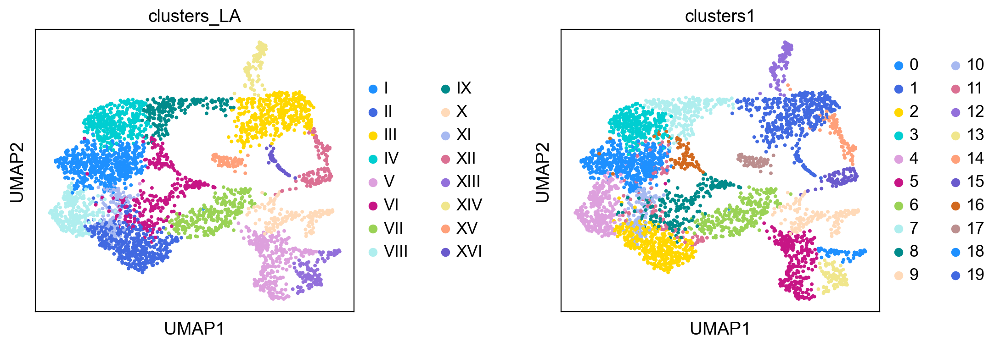

In [77]:
sc.pl.umap(
    adata, color=["clusters_LA","clusters1"], palette=visium_cl, wspace=0.5,
)

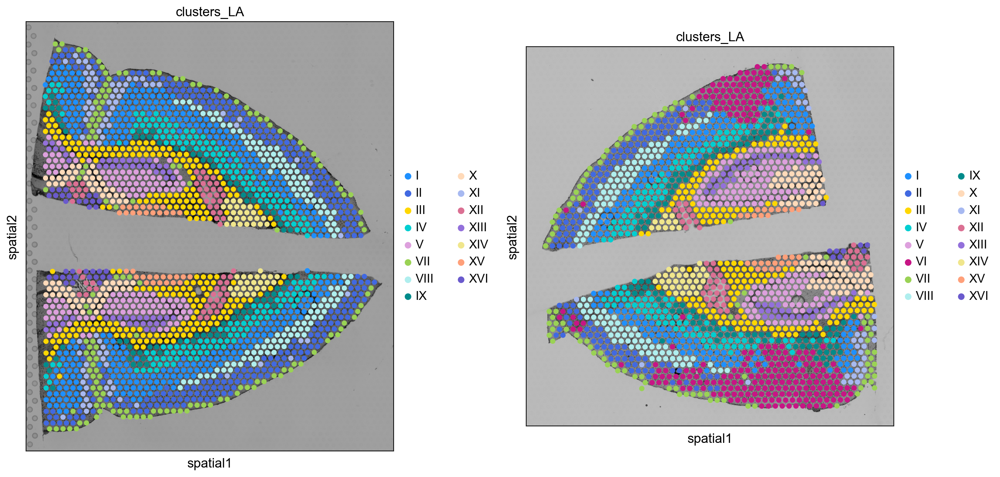

In [79]:
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

for i, library in enumerate(
    ['D_Intact','A_3dpi_V']
):
    ad = adata[adata.obs.library_id == library, :].copy()
    sc.pl.spatial(
        ad,
        img_key="hires",
        library_id=library,
        color=["clusters_LA"],
        size=1.2,
        show=False,
        ax=axs[i],
#        save=i
    )

plt.tight_layout()


In [80]:
pd.DataFrame(adata.var_names).to_csv(table_dir + 'adata_visium_background.csv')

## Cell cycle

In [81]:
cell_cycle_genes = [x.strip() for x in open('/Volumes/Seagate_Exp/Single_cell_112020/regev_lab_cell_cycle_genes_mouse.txt')]

In [82]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [83]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    731 total control genes are used. (0:00:00)
computing score 'G2M_score'


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'G2M_score', score of gene set (adata.obs).
    766 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


In [84]:
pair2= ["#009B77", "#ff8080", "#ffbf00", "#9AD255", "#9AD255",
       "#b30047",   "#dada2b", "#dada2b"]

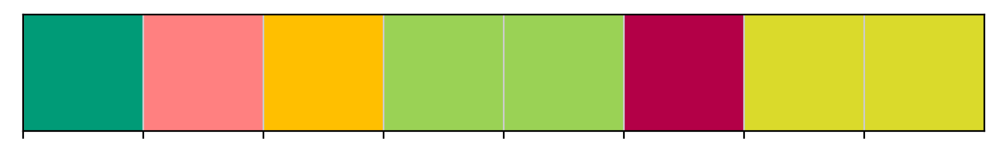

In [85]:
sb.palplot(pair2)

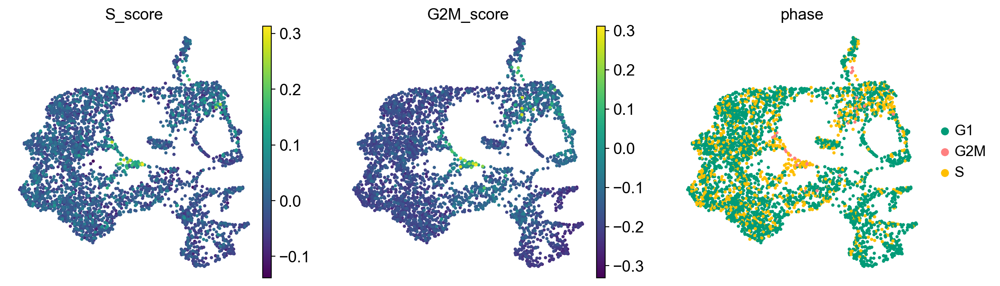

/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


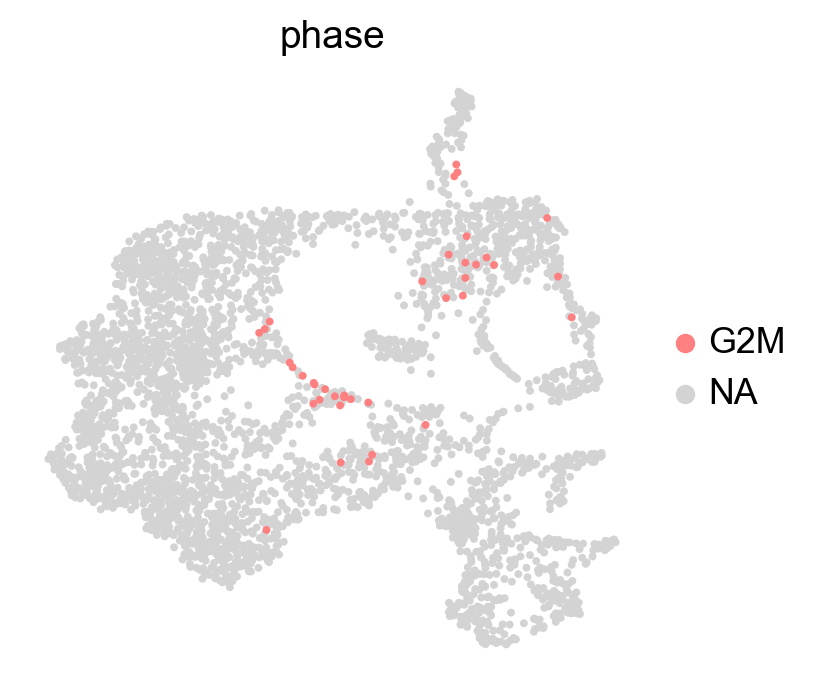

In [86]:
sc.pl.umap(adata, color=['S_score', 'G2M_score', 'phase'],palette=pair2, use_raw=False, frameon=False, )
sc.pl.umap(adata, color='phase',groups=['G2M'],  palette=pair2, use_raw=False, frameon=False)

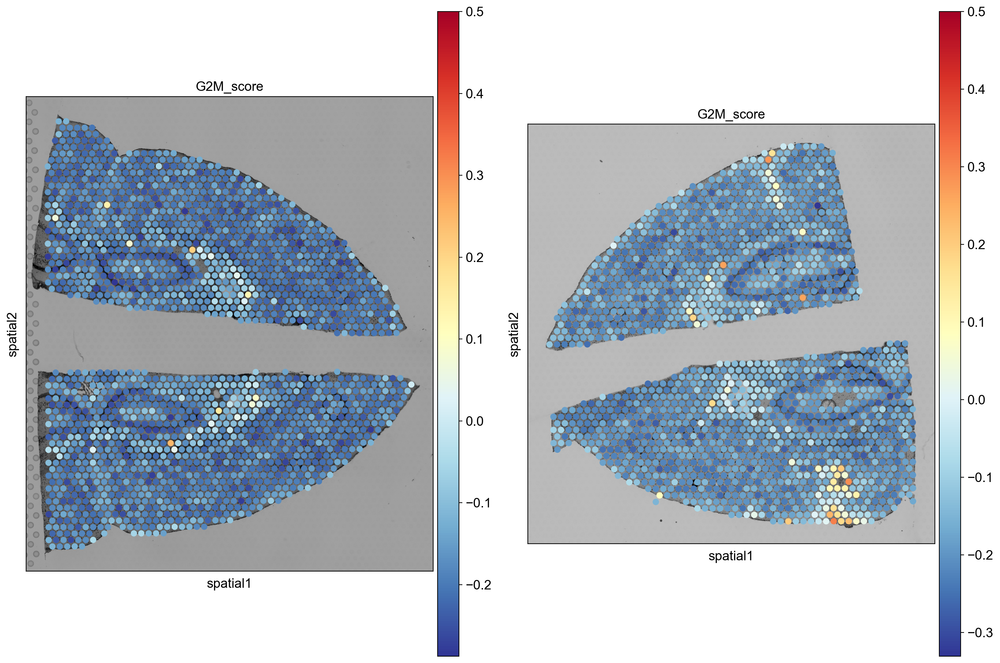

In [87]:
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

for i, library in enumerate(
    ['D_Intact','A_3dpi_V']
):
    ad = adata[adata.obs.library_id == library, :].copy()
    sc.pl.spatial(
        ad,
        img_key="hires",
        library_id=library,
        color="G2M_score", cmap='RdYlBu_r', 
        size=1.3, vmax=0.5,
        show=False,
        ax=axs[i],
#        save=i
    )

plt.tight_layout()


In [88]:
adata.write(data_dir+today+"adata_spatial_intact_3dpi_V_paper.h5ad")